# Fourier transforms and audio

## Phys481 Fall 2017  Week 10  


In [11]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

## FFT
The fast fourier transform takes a sequence of numbers and returns another sequence of the same length.  Both input and output may be complex.

In [12]:
# FFT of 8 zeros is 8 zeros.
np.fft.fft( np.zeros(8) )

array([ 0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,
        0.+0.j])

In [13]:
# FFT of 8 ones is a spike at zero (DC offset)
np.fft.fft( np.ones(8) )

array([ 8.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,  0.+0.j,
        0.+0.j])

In [14]:
# FFT of a DC offset is 8 ones
np.fft.fft( np.array([1,0,0,0, 0,0,0,0]) )

array([ 1.+0.j,  1.+0.j,  1.+0.j,  1.+0.j,  1.+0.j,  1.+0.j,  1.+0.j,
        1.+0.j])

In [15]:
# FFT of a spike is a complex sinusoid
np.fft.fft( np.array([0,1,0,0, 0,0,0,0]) )

array([ 1.00000000+0.j        ,  0.70710678-0.70710678j,
        0.00000000-1.j        , -0.70710678-0.70710678j,
       -1.00000000+0.j        , -0.70710678+0.70710678j,
        0.00000000+1.j        ,  0.70710678+0.70710678j])

## Formatted output

By default, the way that Numpy prints an array of complex numbers is acceptable.  However, what if we wanted to make some formatting changes?



In [16]:
# Print one value
#
z = np.fft.fft( np.array([0,1,0,0, 0,0,0,0]) )
'{0[0]:6.2f}'.format( z ) 

'1.00+0.00j'

In [17]:
z

array([ 1.00000000+0.j        ,  0.70710678-0.70710678j,
        0.00000000-1.j        , -0.70710678-0.70710678j,
       -1.00000000+0.j        , -0.70710678+0.70710678j,
        0.00000000+1.j        ,  0.70710678+0.70710678j])

In [18]:
# only prints one value...
#
'{0:6.2f}'.format( *z )

'1.00+0.00j'

In [19]:
# only one value
#
'{:6.2f}'.format( *z )

'1.00+0.00j'

In [20]:
# two values
'{:6.2f} {:6.2f}'.format( *z )

'1.00+0.00j 0.71-0.71j'

In [21]:
# 8 values
'{:6.2f} '*8

'{:6.2f} {:6.2f} {:6.2f} {:6.2f} {:6.2f} {:6.2f} {:6.2f} {:6.2f} '

In [22]:
# 8 values in one string
('{:6.2f} '*8).format( *z )

'1.00+0.00j 0.71-0.71j 0.00-1.00j -0.71-0.71j -1.00+0.00j -0.71+0.71j 0.00+1.00j 0.71+0.71j '

In [23]:
# 8 values in 8 strings
['{:6.2f}'.format(x) for x in z]

['1.00+0.00j',
 '0.71-0.71j',
 '0.00-1.00j',
 '-0.71-0.71j',
 '-1.00+0.00j',
 '-0.71+0.71j',
 '0.00+1.00j',
 '0.71+0.71j']

In [24]:
' '.join( map( lambda x: '{:6.2f}'.format(x), z) )

'1.00+0.00j 0.71-0.71j 0.00-1.00j -0.71-0.71j -1.00+0.00j -0.71+0.71j 0.00+1.00j 0.71+0.71j'

### Challenge: find some alternative(s)
My FORTRAN mind thinks that there *must* be some better way to write this.  Try and find shorter/clearer methods to format a numpy array.

## Back to the FFT


In [25]:
('{:6.2f} '*8).format( *np.fft.fft( np.array([0,1,0,0, 0,0,0,0]) ) )

'1.00+0.00j 0.71-0.71j 0.00-1.00j -0.71-0.71j -1.00+0.00j -0.71+0.71j 0.00+1.00j 0.71+0.71j '

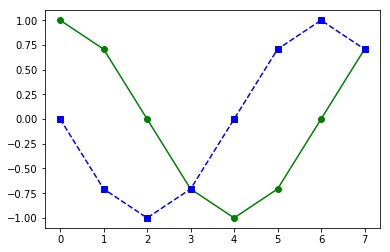

In [26]:
z = np.fft.fft( np.array([0,1,0,0, 0,0,0,0]) )
plt.plot( z.real, 'go-' )
plt.plot( z.imag, 'bs--')

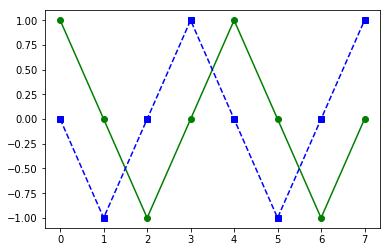

In [27]:
z = np.fft.fft( np.array([0,0,1,0, 0,0,0,0]) )
plt.plot( z.real, 'go-' )
plt.plot( z.imag, 'bs--')

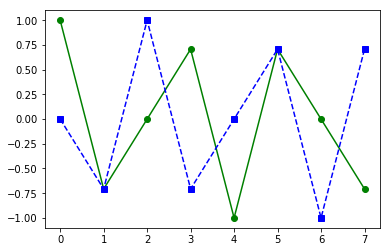

In [28]:
z = np.fft.fft( np.array([0,0,0,1, 0,0,0,0]) )
plt.plot( z.real, 'go-' )
plt.plot( z.imag, 'bs--')

Make a set of 8-element vectors that each has 1 in a different element, and zeros in all the others.  Then take the FFT of each one to get a family of corresponding frequency spectra.

In [29]:
x = np.array([1,0,0,0, 0,0,0,0])
for i in range(len(x)):
    z = np.roll(x,i)
    print( ('{:6.2f} '*8).format( *z ) )

  1.00   0.00   0.00   0.00   0.00   0.00   0.00   0.00 
  0.00   1.00   0.00   0.00   0.00   0.00   0.00   0.00 
  0.00   0.00   1.00   0.00   0.00   0.00   0.00   0.00 
  0.00   0.00   0.00   1.00   0.00   0.00   0.00   0.00 
  0.00   0.00   0.00   0.00   1.00   0.00   0.00   0.00 
  0.00   0.00   0.00   0.00   0.00   1.00   0.00   0.00 
  0.00   0.00   0.00   0.00   0.00   0.00   1.00   0.00 
  0.00   0.00   0.00   0.00   0.00   0.00   0.00   1.00 


In [30]:
x = np.array([1,0,0,0, 0,0,0,0])
for i in range(len(x)):
    z = np.roll(x,i)
    print( ('{:+6.2f}  '*8).format( *np.fft.fft(z) ) )


+1.00+0.00j  +1.00+0.00j  +1.00+0.00j  +1.00+0.00j  +1.00+0.00j  +1.00+0.00j  +1.00+0.00j  +1.00+0.00j  
+1.00+0.00j  +0.71-0.71j  +0.00-1.00j  -0.71-0.71j  -1.00+0.00j  -0.71+0.71j  +0.00+1.00j  +0.71+0.71j  
+1.00+0.00j  -0.00-1.00j  -1.00+0.00j  +0.00+1.00j  +1.00+0.00j  -0.00-1.00j  -1.00+0.00j  +0.00+1.00j  
+1.00+0.00j  -0.71-0.71j  +0.00+1.00j  +0.71-0.71j  -1.00+0.00j  +0.71+0.71j  +0.00-1.00j  -0.71+0.71j  
+1.00+0.00j  -1.00+0.00j  +1.00+0.00j  -1.00+0.00j  +1.00+0.00j  -1.00+0.00j  +1.00+0.00j  -1.00+0.00j  
+1.00+0.00j  -0.71+0.71j  +0.00-1.00j  +0.71+0.71j  -1.00+0.00j  +0.71-0.71j  +0.00+1.00j  -0.71-0.71j  
+1.00+0.00j  +0.00+1.00j  -1.00+0.00j  -0.00-1.00j  +1.00+0.00j  +0.00+1.00j  -1.00+0.00j  -0.00-1.00j  
+1.00+0.00j  +0.71+0.71j  +0.00+1.00j  -0.71+0.71j  -1.00+0.00j  -0.71-0.71j  +0.00-1.00j  +0.71-0.71j  


## Sinusoid with a noisy background.

Add noise to a sinuosid to get a result that looks messy in the time domain.  A Fourier transform will re-arrange the information, placing the harmonic energy in a few bins while the noise will be approximately uniformly distributed.

Chop out the noise, FFT back, and get a much nicer sinusoid.

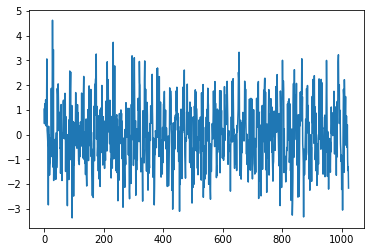

In [31]:
n = 1024
x = np.random.randn(n) + np.sin( 0.3*np.arange(0,n) )
plt.plot(x)

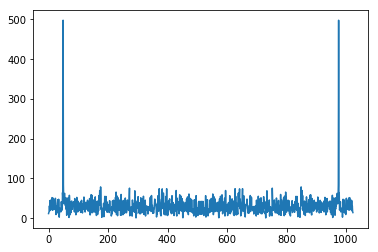

In [32]:
z = np.fft.fft(x)
plt.plot( np.abs(z) )

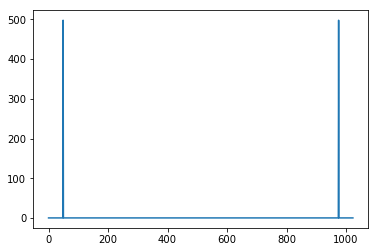

In [33]:
zclean = z * (np.abs(z)>100)
plt.plot( np.abs(zclean) )


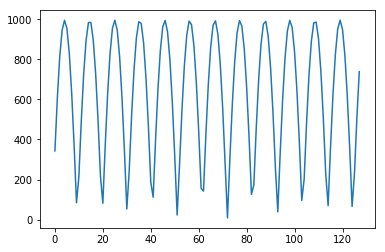

In [34]:
plt.plot( np.abs( np.fft.fft(zclean))[0:128])

## Audio processing

In [35]:
from IPython.display import Audio

# constant frequency tone
#
Audio(np.sin(np.linspace(0, 3000, 30000)), rate=20000)

In [36]:
s1 = np.sin(np.linspace(0, 3000, 20000))
s2 = np.sin(np.linspace(1000, 8000, 20000))
Audio(s1+s2, rate=20000)

In [84]:
data = np.random.uniform(-1,1,44100) # 44100 random samples between -1 and 1
scaled = np.int16(data/np.max(np.abs(data)) * 32767)
Audio( scaled, rate= 20000)

In [38]:
import scipy.io.wavfile
#http://www.astrosurf.com/luxorion/audiofiles-geomagnetosphere.htm
#url = r'http://www.astrosurf.com/luxorion/Radio/chorus-cluster2-gurnett.wav'
datafilename = r'chorus-cluster2-gurnett.wav'
datarate, wavedata = scipy.io.wavfile.read(datafilename)
Audio( wavedata, rate=datarate)


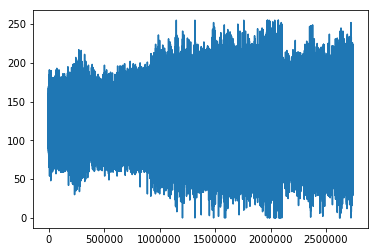

In [39]:
# show time series
plt.clf() ; plt.plot( wavedata )

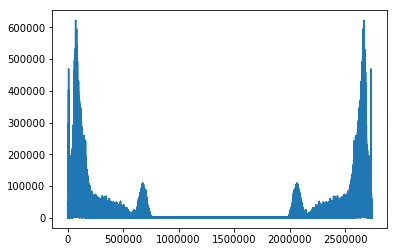

In [40]:
freqdata = np.fft.fft(wavedata)
freqdata[0] = 0  # there is often a spike at zero frequence
plt.plot( np.abs(freqdata) )

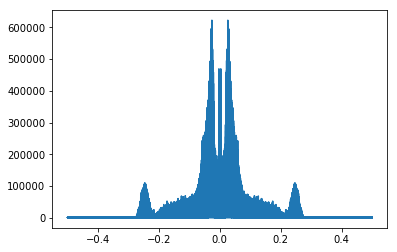

In [41]:
fftfreq = np.fft.fftfreq( len(wavedata) )
plt.plot( fftfreq, np.abs(freqdata) )

In [48]:
###### lowpass = np.abs(fftfreq) < 0.05
lowdata = np.real( np.fft.fft( lowpass * freqdata ) )
lowdata /= np.max(np.abs(lowdata)) / 32767
lowdata -= np.mean(lowdata)
Audio( lowdata, rate= 44100)

In [86]:
highpass = np.abs(fftfreq) > 0.05
highdata = np.real( np.fft.fft( highpass * freqdata ) )
highdata /= np.max(np.abs(highdata)) / 32767 
highdata -= np.mean(highdata)
Audio( highdata, rate= 44100)

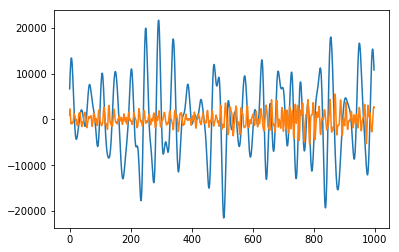

In [88]:
# take a look at a small segment to see high/low frequency bands
plt.plot( lowdata[0:999])  
plt.plot( highdata[0:999])

In [97]:
stereodata = np.array( [0.5*lowdata, 2.0*highdata] )
stereodata.shape
Audio( stereodata, rate= 1*44100)

## Time-frequency spectrograph

In [137]:
nblock = 1024
grid = np.ndarray([ len(wavedata)//nblock, nblock-1], dtype=np.float)
for indx in range(len(grid)):
    spect = np.fft.fft( wavedata[nblock*indx : nblock*(indx+1)])
    grid[indx,:] = np.abs( spect[1:] )

In [138]:
len(grid)

2678

In [139]:
np.ndarray([2,3])

array([[ 30000.,  20000.,  10000.],
       [ 10000.,  20000.,  30000.]])

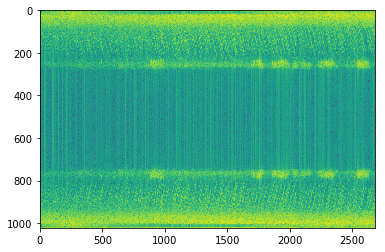

In [34]:
plt.imshow( np.log(grid.T+0.01), aspect='auto')

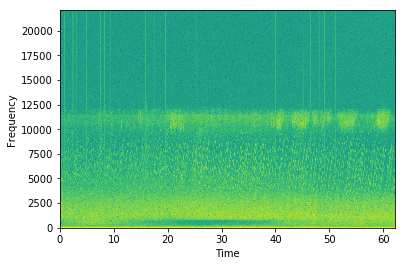

In [35]:
# Appears to be the same as a built-in function

fs = 44100   # sampling frequency
S, freqs, bins, im = plt.specgram(wavedata, NFFT=1024, Fs=fs, noverlap=512)

# Plot a spectrogram
plt.xlabel('Time')
plt.ylabel('Frequency')

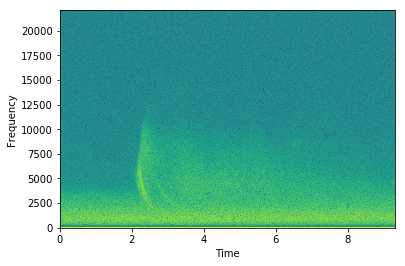

In [36]:
datafilename = r'whistler-cluster3-4-gurnett.wav'
datarate, wavedata = scipy.io.wavfile.read(datafilename)
S, freqs, bins, im = plt.specgram(wavedata[:,0], NFFT=1024, Fs=fs, noverlap=512)

# Plot a spectrogram
plt.xlabel('Time')
plt.ylabel('Frequency')
#S, freqs, bins, im = plt.specgram(wavedata, NFFT=1024, Fs=fs, noverlap=512)

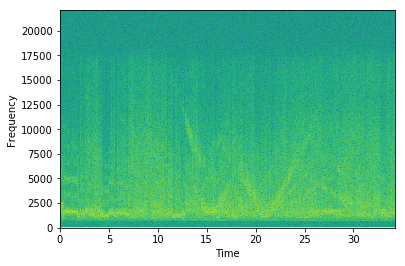

In [37]:
datafilename = r'saucers-dynamics-explorer-gurnett.wav'
datarate, wavedata = scipy.io.wavfile.read(datafilename)
S, freqs, bins, im = plt.specgram(wavedata, NFFT=1024, Fs=fs, noverlap=512)

# Plot a spectrogram
plt.xlabel('Time')
plt.ylabel('Frequency')
#S, freqs, bins, im = plt.specgram(wavedata, NFFT=1024, Fs=fs, noverlap=512)

/home/bjackel/miniconda3/lib/python3.5/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


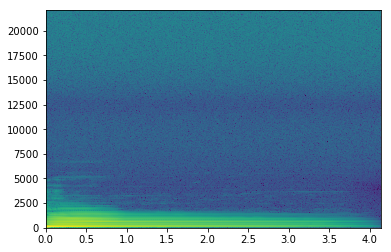

In [38]:
# http://freewavesamples.com/alesis-fusion-fretless-bass-c3
datarate, wavedata = scipy.io.wavfile.read('Alesis-Fusion-Fretless-Bass-C3.wav')
wavedata.shape
S, freqs, bins, im = plt.specgram(wavedata[:,0], NFFT=1024, Fs=fs, noverlap=512)
Audio( wavedata.T, rate=datarate)

/home/bjackel/miniconda3/lib/python3.5/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


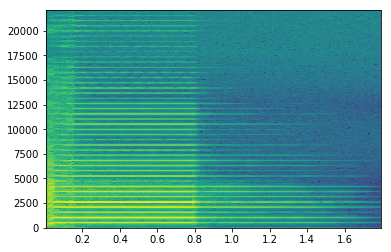

In [39]:
# http://freewavesamples.com/alesis-fusion-violin-c5
datarate, wavedata = scipy.io.wavfile.read('Alesis-Fusion-Violin-C5.wav')
wavedata.shape
S, freqs, bins, im = plt.specgram(wavedata[:,0], NFFT=1024, Fs=fs, noverlap=512)
Audio( wavedata.T, rate=datarate)


### Question: do something interesting with data, sound, spectra, and filtering.  Should be more than one page and less than 10.

In [189]:
from PIL import Image
building=Image.open("8.JPG")


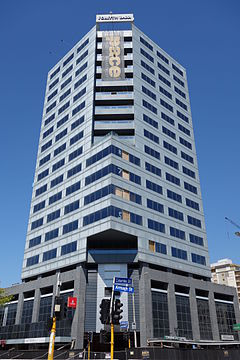

In [190]:
building

In [191]:
buildingarray=np.array(building)

In [192]:
buildingarray.shape

(360, 240, 3)

In [193]:
building=np.array(buildingarray[:,:,2])

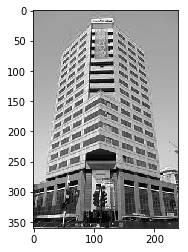

In [194]:
plt.imshow(building,cmap='gray')
plt.show()

In [205]:
building.shape

(360, 240)

In [212]:
Y=[]
for y in range(360):
    Y.append(np.max(np.abs(np.fft.fft(building[y]))))

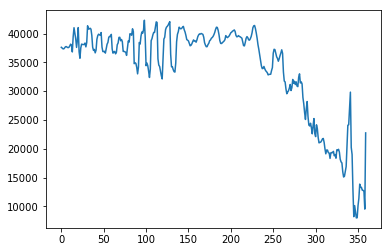

In [213]:

plt.plot(np.abs(Y))
plt.show()

In [215]:
Audio( Y, rate= 4100)

In [226]:
mgrid=np.meshgrid(np.arange(20),np.arange(20))
b=np.fft.fft2(mgrid)

In [232]:
b.shape

(2, 20, 20)

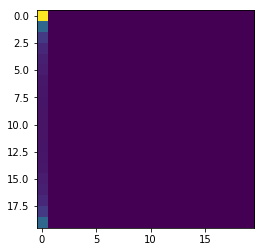

In [233]:
plt.imshow(np.abs(b)[1])
plt.show()

In [244]:
import scipy.io.wavfile
#http://www.astrosurf.com/luxorion/audiofiles-geomagnetosphere.htm
#url = r'http://www.astrosurf.com/luxorion/Radio/chorus-cluster2-gurnett.wav'
#datafilename = 'Never_Gonna_Give_You_Up_Original.wav'
#datarate, wavedata = scipy.io.wavfile.read(datafilename)
#Audio( wavedata, rate=datarate)

import IPython
a=IPython.display.Audio("Never Gonna Give You Up Original.mp3")

In [247]:
a